In this Notebook:

1. Preparation
2. Data cleaning
3. EDA with scatterplots
4. Regression analysis

# 1. Preparation

In [65]:
#importing libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import os
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [66]:
#define path
path = r"/Users/katerinapilota/Desktop/Project_6"

In [67]:
#ensure chart are automatically displayed
%matplotlib inline

In [68]:
#import data
df = pd.read_csv(os.path.join(path, 'Data', 'Prepared Data', 'patent_final.csv'))

In [69]:
#view all not truncated result
pd.set_option('display.max_rows', None)

# 2. Cleaning

In [70]:
df.head(20)

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Office,Office (Code),Applicant Origin - Country,"1 - Electrical machinery, apparatus, energy",2 - Audio-visual technology,3 - Telecommunications,4 - Digital communication,...,"33 - Furniture, games",34 - Other consumer goods,35 - Civil engineering,Year,Applicant Origin - Region,Total patent numbers,GDP PPP (per capita),R&D (% GDP),Fertility Rate (15-19 yo),concat
0,20615,20615,20615,European Patent Office,EP,Liechtenstein,13,0,0,0,...,0,0,0,2019,Western Europe,13,NaN,NaN,NaN,Liechtenstein 2019
1,20616,20616,20616,Germany,DE,Liechtenstein,1,0,0,0,...,0,0,0,2019,Western Europe,1,NaN,NaN,NaN,Liechtenstein 2019
2,20617,20617,20617,Italy,IT,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
3,20618,20618,20618,Japan,JP,Liechtenstein,1,0,0,0,...,0,0,0,2019,Western Europe,1,NaN,NaN,NaN,Liechtenstein 2019
4,20619,20619,20619,Poland,PL,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
5,20620,20620,20620,Republic of Korea,KR,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
6,20621,20621,20621,South Africa,ZA,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
7,20622,20622,20622,Switzerland,CH,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
8,20623,20623,20623,United Kingdom,GB,Liechtenstein,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
9,20624,20624,20624,United States of America,US,Liechtenstein,11,0,0,0,...,0,0,0,2019,Western Europe,11,NaN,NaN,NaN,Liechtenstein 2019


In [71]:
df.shape

(39335, 48)

In [72]:
#dropping unnecessary index columns
df.drop(columns = ['Unnamed: 0', 'Unnamed: 0.1', 'Unnamed: 0.1.1'], inplace = True)

In [73]:
df.head()

,Office,Office (Code),Applicant Origin - Country,"1 - Electrical machinery, apparatus, energy",2 - Audio-visual technology,3 - Telecommunications,4 - Digital communication,5 - Basic communication processes,6 - Computer technology,7 - IT methods for management,...,"33 - Furniture, games",34 - Other consumer goods,35 - Civil engineering,Year,Applicant Origin - Region,Total patent numbers,GDP PPP (per capita),R&D (% GDP),Fertility Rate (15-19 yo),concat
0,European Patent Office,EP,Liechtenstein,13,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,13,NaN,NaN,NaN,Liechtenstein 2019
1,Germany,DE,Liechtenstein,1,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,1,NaN,NaN,NaN,Liechtenstein 2019
2,Italy,IT,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019
3,Japan,JP,Liechtenstein,1,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,1,NaN,NaN,NaN,Liechtenstein 2019
4,Poland,PL,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,0,NaN,NaN,NaN,Liechtenstein 2019


In [74]:
#checking for NaNs
df.isnull().sum()

Office                                            0
Office (Code)                                     0
Applicant Origin - Country                        0
1 - Electrical machinery, apparatus, energy       0
2 - Audio-visual technology                       0
3 - Telecommunications                            0
4 - Digital communication                         0
5 - Basic communication processes                 0
6 - Computer technology                           0
7 - IT methods for management                     0
8 - Semiconductors                                0
9 - Optics                                        0
10 - Measurement                                  0
11 - Analysis of biological materials             0
12 - Control                                      0
13 - Medical technology                           0
14 - Organic fine chemistry                       0
15 - Biotechnology                                0
16 - Pharmaceuticals                              0
17 - Macromo

In [75]:
#dropping 'concat' column
df.drop(columns = ['concat'], inplace = True)

In [76]:
#exploring more about the NaNs
Nans = df.loc[df.isnull().any(axis=1)]

In [77]:
Nans.shape

(10823, 44)

In [78]:
Nans['Applicant Origin - Country'].value_counts()

United States of America                 2844
Switzerland                              1603
Republic of Korea                        1337
Unknown                                   897
Australia                                 829
Liechtenstein                             465
China, Hong Kong SAR                      317
South Africa                              286
Brazil                                    203
Luxembourg                                185
New Zealand                               179
Monaco                                    110
Republic of Moldova                       107
Netherlands Antilles                      104
Morocco                                    88
Belarus                                    86
Barbados                                   86
Malaysia                                   73
Singapore                                  57
Saudi Arabia                               55
Venezuela (Bolivarian Republic of)         52
Bulgaria                          

In [79]:
df.drop(df[df['Applicant Origin - Country'] == 'Unknown'].index, inplace = True)
Nans.drop(Nans[Nans['Applicant Origin - Country'] == 'Unknown'].index, inplace = True)

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [80]:
Nans['Applicant Origin - Country'].value_counts()

United States of America                 2844
Switzerland                              1603
Republic of Korea                        1337
Australia                                 829
Liechtenstein                             465
China, Hong Kong SAR                      317
South Africa                              286
Brazil                                    203
Luxembourg                                185
New Zealand                               179
Monaco                                    110
Republic of Moldova                       107
Netherlands Antilles                      104
Morocco                                    88
Barbados                                   86
Belarus                                    86
Malaysia                                   73
Singapore                                  57
Saudi Arabia                               55
Venezuela (Bolivarian Republic of)         52
Bulgaria                                   50
Thailand                          

In [81]:
#comparing Nans in USA with total USA tuples
df['Applicant Origin - Country'].value_counts()

United States of America                 2844
Germany                                  2578
France                                   2070
Japan                                    2010
Switzerland                              1954
United Kingdom                           1849
Netherlands                              1722
Sweden                                   1609
Italy                                    1513
Finland                                  1369
Republic of Korea                        1337
Canada                                   1281
Austria                                  1274
Belgium                                  1172
Denmark                                  1146
Australia                                1043
Spain                                     987
Norway                                    925
Israel                                    767
China                                     746
Ireland                                   600
Russian Federation                

In [82]:
#creating a subset to look further at USA 
USA = df[df['Applicant Origin - Country'] == 'United States of America']

In [83]:
USA.shape

(2844, 44)

In [84]:
USA #it is clear that there is only one IV (adolescent fertility rate missing - so dropping all the USA rows is unnecessary and detrimental to overall analysis)

,Office,Office (Code),Applicant Origin - Country,"1 - Electrical machinery, apparatus, energy",2 - Audio-visual technology,3 - Telecommunications,4 - Digital communication,5 - Basic communication processes,6 - Computer technology,7 - IT methods for management,...,32 - Transport,"33 - Furniture, games",34 - Other consumer goods,35 - Civil engineering,Year,Applicant Origin - Region,Total patent numbers,GDP PPP (per capita),R&D (% GDP),Fertility Rate (15-19 yo)
16351,African Regional Intellectual Property Organiz...,AP,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,1,34513.56150,2.54965,NaN
16352,Australia,AU,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,230,34513.56150,2.54965,NaN
16353,Austria,AT,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,1,34513.56150,2.54965,NaN
16354,Bulgaria,BG,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,5,34513.56150,2.54965,NaN
16355,Canada,CA,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,292,34513.56150,2.54965,NaN
16356,China,CN,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,56,34513.56150,2.54965,NaN
16357,Croatia,HR,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,2,34513.56150,2.54965,NaN
16358,Czechoslovakia,CS,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,1,34513.56150,2.54965,NaN
16359,Czech Republic,CZ,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,5,34513.56150,2.54965,NaN
16360,Denmark,DK,United States of America,0,0,0,0,0,0,0,...,0,0,0,0,1999,Northern America,3,34513.56150,2.54965,NaN


In [85]:
#creating a subset of Switzerland (country with next-highest number of Nans)
CHE = df[df['Applicant Origin - Country'] == 'Switzerland']

In [86]:
CHE.shape #Switzerland has some complete tuples, but not many (rows with Nans = 1603)

(1954, 44)

In [87]:
CHE #again you can see that most of the missing values are in the R&D 

,Office,Office (Code),Applicant Origin - Country,"1 - Electrical machinery, apparatus, energy",2 - Audio-visual technology,3 - Telecommunications,4 - Digital communication,5 - Basic communication processes,6 - Computer technology,7 - IT methods for management,...,32 - Transport,"33 - Furniture, games",34 - Other consumer goods,35 - Civil engineering,Year,Applicant Origin - Region,Total patent numbers,GDP PPP (per capita),R&D (% GDP),Fertility Rate (15-19 yo)
15431,Australia,AU,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,11,33814.07929,NaN,5.5508
15432,Austria,AT,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,4,33814.07929,NaN,5.5508
15433,Canada,CA,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,10,33814.07929,NaN,5.5508
15434,China,CN,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,9,33814.07929,NaN,5.5508
15435,Czechoslovakia,CS,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,1,33814.07929,NaN,5.5508
15436,Czech Republic,CZ,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,4,33814.07929,NaN,5.5508
15437,Denmark,DK,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,1,33814.07929,NaN,5.5508
15438,Estonia,EE,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,1,33814.07929,NaN,5.5508
15439,Eurasian Patent Organization,EA,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,2,33814.07929,NaN,5.5508
15440,European Patent Office,EP,Switzerland,0,0,0,0,0,0,0,...,0,0,0,0,1999,Western Europe,67,33814.07929,NaN,5.5508


# Notes about further EDA steps + Hypothesis

As too much data will be lost by dropping whole rows with missing values in 1 (or 2 ) of the IVs I will instead create subsets containing 1 x IV and the patent data to explore relationships further using scatterplots
I will also re-add the additional 'patent category flag' column
Hypothesis: #Countries with higher patent output have higher GDPs (PPP, per capita), spend more on R&D (as. % of GDP) and have lower rates of teenage pregnancy (as a percentage of total fertility)

# 3. EDA with scatterplots

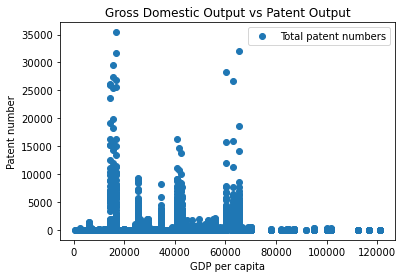

In [88]:
# Create scatterplots using matplotlib for another look at how the variables plot against each other (using all data, only higher performing countries)

#GDP
df.plot(x = 'GDP PPP (per capita)', y='Total patent numbers',style='o') # The style option creates a scatterplot; without it, we only have lines.
plt.title('Gross Domestic Output vs Patent Output')  
plt.xlabel('GDP per capita')  
plt.ylabel('Patent number')  
plt.show()

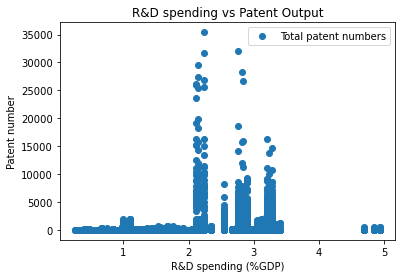

In [89]:
#R&D spending
df.plot(x = 'R&D (% GDP)', y='Total patent numbers',style='o')
plt.title('R&D spending vs Patent Output')  
plt.xlabel('R&D spending (%GDP)')  
plt.ylabel('Patent number')  
plt.show()

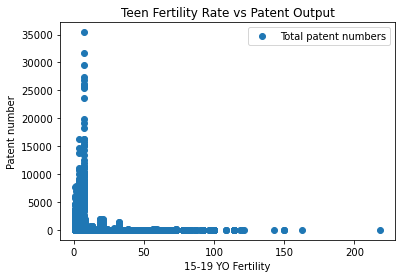

In [90]:
#Adolescent Fertility Rate
df.plot(x = 'Fertility Rate (15-19 yo)', y='Total patent numbers',style='o')
plt.title('Teen Fertility Rate vs Patent Output')  
plt.xlabel('15-19 YO Fertility')  
plt.ylabel('Patent number')  
plt.show()

Now, just using the high performing countries' data to see if there is anything sigificant

In [91]:
#adding the patent category flag column using loc
df.loc[df['Total patent numbers'] < 2.0, 'Patent count category'] = 'Low'

In [92]:
df.loc[(df['Total patent numbers'] >= 2.0) & (df['Total patent numbers'] < 5.0), 'Patent count category'] = 'Middle'

In [93]:
df.loc[df['Total patent numbers'] >= 24.0, 'Patent count category'] = 'High'

In [94]:
#checking new 'Patent count category' column
df['Patent count category'].value_counts()

High      9816
Low       9457
Middle    8572
Name: Patent count category, dtype: int64

In [95]:
high = df.loc[df['Patent count category'] == 'High']

In [96]:
high

,Office,Office (Code),Applicant Origin - Country,"1 - Electrical machinery, apparatus, energy",2 - Audio-visual technology,3 - Telecommunications,4 - Digital communication,5 - Basic communication processes,6 - Computer technology,7 - IT methods for management,...,"33 - Furniture, games",34 - Other consumer goods,35 - Civil engineering,Year,Applicant Origin - Region,Total patent numbers,GDP PPP (per capita),R&D (% GDP),Fertility Rate (15-19 yo),Patent count category
61,European Patent Office,EP,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,41,NaN,NaN,NaN,High
65,United States of America,US,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,24,NaN,NaN,NaN,High
84,European Patent Office,EP,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,29,NaN,NaN,NaN,High
90,European Patent Office,EP,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2019,Western Europe,41,NaN,NaN,NaN,High
137,European Patent Office,EP,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2018,Western Europe,56,NaN,NaN,NaN,High
433,China,CN,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2017,Western Europe,30,NaN,NaN,NaN,High
434,European Patent Office,EP,Liechtenstein,0,0,0,0,0,0,0,...,0,0,0,2017,Western Europe,47,NaN,NaN,NaN,High
568,United States of America,US,India,0,0,0,0,0,0,0,...,0,0,0,1999,Southern Asia,32,2009.215647,0.724130,70.1760,High
647,China,CN,China,0,0,0,0,0,0,0,...,0,0,0,1999,Eastern Asia,111,2653.973626,0.749632,10.4920,High
658,China,CN,China,92,0,0,0,0,0,0,...,0,0,0,1999,Eastern Asia,92,2653.973626,0.749632,10.4920,High


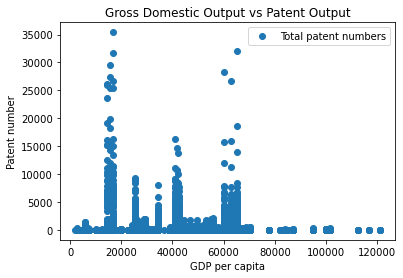

In [97]:
#creating scatteplots with matplotlib with the segmented data
#GDP
high.plot(x = 'GDP PPP (per capita)', y='Total patent numbers',style='o') # The style option creates a scatterplot; without it, we only have lines.
plt.title('Gross Domestic Output vs Patent Output')  
plt.xlabel('GDP per capita')  
plt.ylabel('Patent number')  
plt.show()

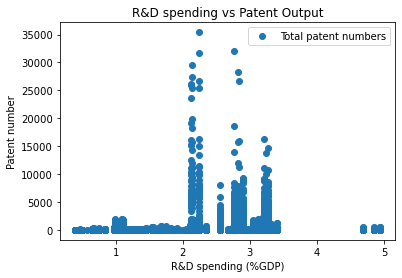

In [98]:
high.plot(x = 'R&D (% GDP)', y='Total patent numbers',style='o')
plt.title('R&D spending vs Patent Output')  
plt.xlabel('R&D spending (%GDP)')  
plt.ylabel('Patent number')  
plt.show()

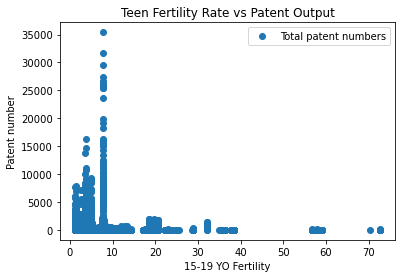

In [99]:
#Adolescent Fertility Rate
high.plot(x = 'Fertility Rate (15-19 yo)', y='Total patent numbers',style='o')
plt.title('Teen Fertility Rate vs Patent Output')  
plt.xlabel('15-19 YO Fertility')  
plt.ylabel('Patent number')  
plt.show()

There is not a huge difference in output, so I will use the full dataset going forward. 

# 4. Regression analysis

4a. Data prep

In [131]:
#creating a subset of the df using just fertility and patent variabl;es, so we can get rid of all the Nans, but keep as many rows as possible.
df2 = df[['GDP PPP (per capita)', 'Total patent numbers']]

In [132]:
df2.head()

,GDP PPP (per capita),Total patent numbers
0,NaN,13
1,NaN,1
2,NaN,0
3,NaN,1
4,NaN,0


In [133]:
#dropping rows with Nans from df2
df2.dropna(inplace = True)

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [134]:
#checking no duplicates are left
df2.isnull().sum()

GDP PPP (per capita)    0
Total patent numbers    0
dtype: int64

In [135]:
#checking the shape of df2
df2.shape

(37362, 2)

In [136]:
# Reshaping the variables (fertility vs patent numbers) from df2 into NumPy arrays and put them into separate objects.
X = df2['GDP PPP (per capita)'].values.reshape(-1,1)
y = df2['Total patent numbers'].values.reshape(-1,1)

In [137]:
X

array([[   602.767045 ],
       [   652.9793022],
       [   797.65834  ],
       ...,
       [120962.1878   ],
       [120962.1878   ],
       [120962.1878   ]])

In [138]:
y

array([[ 1],
       [ 1],
       [ 1],
       ...,
       [17],
       [ 5],
       [ 1]])

Hypothesis for this linear regression: Higher levels of R&D spending predict higher patent output.

Independent variable (X): R&D spending (%GDP)
Dependent variable (y): patent number

In [139]:
# Split data into a training set and a test set.

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

4b. Regression analysis

In [140]:
# Create a regression object.

regression = LinearRegression()

In [141]:
# Fit the regression object onto the training set.

regression.fit(X_train, y_train)

LinearRegression()

In [142]:
# Fit the regression object onto the training set.

regression.fit(X_train, y_train)

LinearRegression()

In [143]:
# Predict the values of y using X.

y_predicted = regression.predict(X_test)

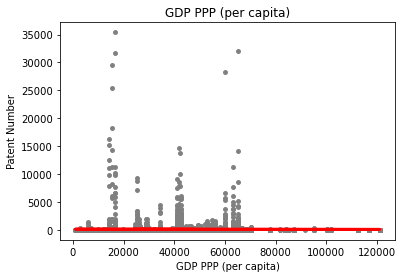

In [144]:
# Create a plot that shows the regression line from the model on the test set.

plot_test = plt
plot_test.scatter(X_test, y_test, color='gray', s = 15)
plot_test.plot(X_test, y_predicted, color='red', linewidth =3)
plot_test.title('GDP PPP (per capita)')
plot_test.xlabel('GDP PPP (per capita)')
plot_test.ylabel('Patent Number')
plot_test.show()

In [145]:
# Create objects that contain the model summary statistics.

rmse = mean_squared_error(y_test, y_predicted) # This is the mean squared error
r2 = r2_score(y_test, y_predicted) # This is the R2 score. 

In [146]:
# Print the model summary statistics. This is where you evaluate the performance of the model.

print('Slope:' ,regression.coef_)
print('Mean squared error: ', rmse)
print('R2 score: ', r2)

Slope: [[-0.00035358]]
Mean squared error:  951260.4557192677
R2 score:  2.6706590493530413e-06


In [147]:
y_predicted

array([[120.81260145],
       [111.58558465],
       [106.35729493],
       ...,
       [127.39159841],
       [108.70783409],
       [112.65267526]])

In [148]:
# Create a dataframe comparing the actual and predicted values of y.

data = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_predicted.flatten()})
data.head(30)

,Actual,Predicted
0,11,120.812601
1,7,111.585585
2,4,106.357295
3,3,122.492806
4,1,125.350007
5,3,114.529186
6,11,105.409277
7,1,111.162172
8,24,115.691450
9,20,124.373234


4c. Comparing the 2 models
The predicted and actual values are off - and the relationship between the two variables are unclear. 

In [149]:
# Predict.

y_predicted_train = regression.predict(X_train) # This is predicting X_train!

In [150]:
rmse = mean_squared_error(y_train, y_predicted_train)
r2 = r2_score(y_train, y_predicted_train)

In [151]:
print('Slope:' ,regression.coef_)
print('Mean squared error: ', rmse)
print('R2 score: ', r2)

Slope: [[-0.00035358]]
Mean squared error:  603182.5216006057
R2 score:  7.351299802393907e-05


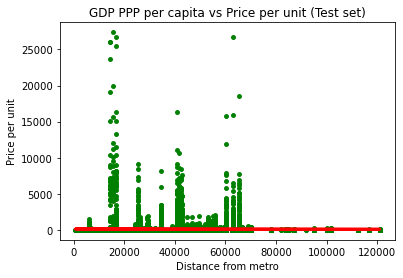

In [152]:
# Visualizing the training set results.

plot_test = plt
plot_test.scatter(X_train, y_train, color='green', s = 15)
plot_test.plot(X_train, y_predicted_train, color='red', linewidth =3)
plot_test.title('GDP PPP per capita vs Patent Output (Test set)')
plot_test.xlabel('GDP per capita (PPP)')
plot_test.ylabel('Price per unit')
plot_test.show()

This topic is an imperfect test case for linear regression presciecly because of the vague and environmental causes of something like patent output- which is typically dependent on so many variables. 

It makes for some unsatisfying models. However, removing outliers to improve them would be counter-productive:L the outliers in this case (high performning countries with high patent outputs) are the cases we want to observe. 

In [153]:
# exporting the data 
df.to_pickle(os.path.join(path, 'Data', 'Prepared Data', 'patent_clean_final'))

In [155]:
df.to_csv(os.path.join(path, 'Data', 'Prepared Data', 'patent_clean_final.csv'))